# Slot Generator

This notebook records the attmept to create a automatic workflow for generating slot assembly joint using trimesh. The tool primarily aims at segmenting AI generated human models, involving the following key steps:

- locate the neck
- cut the model into top and bottom parts
- determine the best location for the slot in the section, cut the slot 

## 0 Packages

In [44]:
import trimesh
import numpy as np
import matplotlib.pyplot as plt

## 1 Locate the neck

There are many ways to locate the neck in a human model. Among them, one of the simplest is to look at the section area at various height, and look for the local minimum around 70% height of the body (assuming whole body model, for half-body model or other models, it's necessary to provide an estimated location of the neck for the best robustness of the algorithm).

In [55]:
# load the example mesh
mesh = trimesh.load("girl_model.stl")
mesh.show()

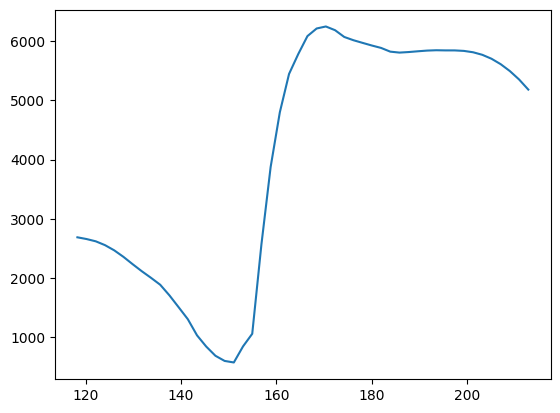

In [153]:
# scan the mesh along z axis and compute cross-section areas

############## Estimated percentage of height of the neck ##########
estimated_neck_height_percentage = 0.70
scan_range = 0.4
####################################################################
z_min, z_max = mesh.vertices[:, 2].min(), mesh.vertices[:, 2].max()
z_min_scan = z_min + (z_max - z_min) * (estimated_neck_height_percentage - scan_range / 2)
z_max_scan = z_min + (z_max - z_min) * (estimated_neck_height_percentage + scan_range / 2)
plane_normal = [0, 0, 1]
zs, areas, centroids, to_3ds= [], [], [], []
for z in np.linspace(z_min_scan, z_max_scan):
    plane_origin = (0, 0, z)
    section = mesh.section(plane_origin=plane_origin, plane_normal=plane_normal)
    if section:
        planars, to_3d = section.to_2D()
        zs.append(z)
        areas.append(planars.area)
        centroids.append(planars.centroid)
        to_3ds.append(to_3d)

plt.plot(zs, areas)

In [78]:
# z neck should be the minimum cross-section area z
zs = np.array(zs)
areas = np.array(areas)
ind_min = areas.argmin()
z_neck = zs[ind_min]
print(f"Neck z position: {z_neck:.1f}")

Neck z position: 151.1


In [90]:
# compute neck center in 3D and area
neck_center_2d = centroids[ind_min]
to_3d = to_3ds[ind_min]
neck_center = trimesh.transform_points(np.array([[neck_center_2d[0], neck_center_2d[1], 0]]), to_3d)[0]
neck_area = areas[ind_min]
print(f"Neck center position: {neck_center}\nNeck cross-section area: {neck_area:.1f}")

Neck center position: [153.23123379 118.10168395 151.10575057]
Neck cross-section area: 575.0


In [156]:
neck_center

array([153.23123379, 118.10168395, 150.10574341])

## 2 Cut the model into top and bottom parts

We will do a cut along `z_neck`. Importantly, to avoid cutting all the way to hair or other part of the model at the same z level, we will perform a closed space cut. Basically, we create a thin cylinder around the neck position, that is slightly bigger than the neck. Then, we subtract this cylinder from the body model, resulting in two separated parts. Lastly, we use `split()` function to separate the two parts into different meshes. 

In [92]:
# create cutter mask
cutter_mask_radius = (neck_area / np.pi ) ** 0.5 + 5
cutter_mask = trimesh.creation.cylinder(radius=cutter_mask_radius, height=2)
cutter_mask.apply_translation(neck_center)

<trimesh.Trimesh(vertices.shape=(66, 3), faces.shape=(128, 3))>

In [95]:
# apply the boolean difference to cut the model at the neck
mesh_after_cut = mesh.difference(cutter_mask, engine="manifold")
mesh_after_cut.show()

In [ ]:
# split the cut model into head and body
parts = mesh_after_cut.split()
parts = sorted(parts, key=lambda x: x.centroid[2], reverse=True) # sort by z coord, so that the first part is head
head_part = parts[0]
body_part = parts[1]

In [101]:
head_part.show()

In [102]:
body_part.show()

In [110]:
body_part.vertices[:, 2].max()

np.float64(150.10574340820312)

In [108]:
head_part.vertices[:, 2].min()

np.float64(151.30471801757812)

To make the model consistent with the original, we still need to union the "cut" cylinder back.

In [120]:
# cut the "cut" cylinder at z_neck
intersection = mesh.intersection(cutter_mask)
cutter_head = trimesh.intersections.slice_mesh_plane(intersection, plane_normal=plane_normal, plane_origin=plane_origin, cap=True)
cutter_body = trimesh.intersections.slice_mesh_plane(intersection, plane_normal=[-n for n in plane_normal], plane_origin=plane_origin, cap=True)

In [121]:
# union head with cutter_head, and body with cutter_body
if cutter_head.volume > 0:
    head = head_part.union(cutter_head)
else:
    head = head_part

if cutter_body.volume > 0:
    body = body_part.union(cutter_body)
else:
    body = body_part

c:\Users\liuzy\Documents\GitHub\Boralus\.venv\Lib\site-packages\trimesh\triangles.py:302: RuntimeWarning: invalid value encountered in divide
  center_mass = integrated[1:4] / volume


In [122]:
body.show()

After putting the cut section back, the resulting model is not as great, because part of the chin is included in the body part, which is undesired. Therefore, wo do not add the cut section back for now, and keep using head_part and body_part as the bases.

## 3 Determine the best location for slot

The simplest way is to put the joint slot at the centroid of the cut section. In this section, we start by reading in the "tool" model. Then decide whether rescaling is required for the model size. We then move the tool to the section centroid. Finally, we apply boolean difference operation.

In [123]:
# read the tool model
male_tool = trimesh.load("male_tool.stl")
female_tool = trimesh.load("female_tool.stl")

### 3.1 Apply the female tool

In [125]:
female_tool.show()

In [ ]:
# determine if rescaling is required
tool_diameter = female_tool.vertices[:, 0].max() - female_tool.vertices[:, 0].min()
section_diameter = (neck_area / np.pi) ** 0.5 * 2 
print(f"Tool diameter is {tool_diameter:.1f}, cut section diameter is {section_diameter:.1f}")

# a parameter "padding_ratio" will be passed to determine the size of the tool, depending on the cut section size

################# PADDING RATIO ####################
padding_ratio = 1.3
####################################################

if tool_diameter * padding_ratio > section_diameter:
    scale = section_diameter / 1.3 / tool_diameter
    female_tool.apply_scale(scale)
    print(f"Tool size is too large, scale tool size down by a factor of {scale:.1f}.")
else:
    print("Tool size ok.")

# NOTE: the same scaling is required for the male tool, no need ot calculated again.

Tool diameter is 20.8, cut section diameter is 27.1
Tool size ok.


In [141]:
# determine the translation
# the idea is to make female tool bottom center coincide with neck_center
translation = neck_center - female_tool.centroid + np.array([0, 0, female_tool.centroid[2]])
female_tool.apply_translation(translation)

<trimesh.Trimesh(vertices.shape=(19019, 3), faces.shape=(38050, 3))>

In [144]:
# visualize the two models
female_tool.visual.face_colors = [100, 149, 237, 255]
scene = trimesh.Scene([head_part, female_tool])
scene.show()

The tool position look correct, we can proceed to boolean operation.

In [146]:
head_part_slot = head_part.difference(female_tool)

In [147]:
head_part_slot.show()

### 3.2 Apply the male tool

In [ ]:
male_tool.show()

In [148]:
male_tool.apply_scale(scale)

<trimesh.Trimesh(vertices.shape=(8935, 3), faces.shape=(17866, 3))>

In [150]:
# determine translation
# the idea is to make the bottom center of the male tool coincide with the centroid of the top surface of body_part
# here we assume the centroid of the body top surface shares x, y with neck center
top_surface_centroid = neck_center
top_surface_centroid[2] = body_part.vertices[:, 2].max()
male_tool_bottom_center = male_tool.centroid.copy()
male_tool_bottom_center[2] = male_tool.vertices[:, 2].min()
translation = top_surface_centroid - male_tool_bottom_center

In [151]:
# apply translation to male tool
male_tool.apply_translation(translation)

<trimesh.Trimesh(vertices.shape=(8935, 3), faces.shape=(17866, 3))>

In [152]:
# visualize
male_tool.visual.face_colors = [100, 149, 237, 255]
scene = trimesh.Scene([body_part, male_tool])
scene.show()

In [154]:
body_part_peg = body_part.union(male_tool)
body_part_peg.show()

## 4 Export the modified models

In [170]:
a = head_part_slot.export("head_part.stl")
b = body_part_peg.export("body_part.stl")

## 5 Organize in functions

In [ ]:
def locate_neck(model, 
                estimated_neck_height_percentage : float = 0.70,
                scan_range : float = 0.4):
    """Find neck position in a human 3D model, in the height range given. The smallest cross-section z is recognized as the neck.
    
    Parameters
    ----------
    model : trimesh.Trimesh
        The human 3D mesh model.
    estimated_neck_height_percentage : float
        Estimated percentage of total model height, where neck is located. The search will be performed only with in h_e +- range/2.
    scan_range : float
        The range of height to scan within. 
    
    Returns
    -------
    neck_center : nd.array
        neck cross section center coords in 3D.
    neck_area : float
        neck cross section area.

    Example
    -------
    >>> mesh = trimesh.load("your_model.stl")
    >>> neck_center, neck_area = locate_neck(mesh)    
    """

    # calculate scan range
    z_min, z_max = mesh.vertices[:, 2].min(), mesh.vertices[:, 2].max()
    z_min_scan = z_min + (z_max - z_min) * (estimated_neck_height_percentage - scan_range / 2)
    z_max_scan = z_min + (z_max - z_min) * (estimated_neck_height_percentage + scan_range / 2)

    # scan cross section area
    plane_normal = [0, 0, 1]
    zs, areas, centroids, to_3ds= [], [], [], []
    for z in np.linspace(z_min_scan, z_max_scan):
        plane_origin = (0, 0, z)
        section = mesh.section(plane_origin=plane_origin, plane_normal=plane_normal)
        if section:
            planars, to_3d = section.to_2D()
            zs.append(z)
            areas.append(planars.area)
            centroids.append(planars.centroid)
            to_3ds.append(to_3d)
    
    # determine z_neck: z neck should be the minimum cross-section area z
    zs = np.array(zs)
    areas = np.array(areas)
    ind_min = areas.argmin()
    z_neck = zs[ind_min]
    print(f"Neck z position: {z_neck:.1f}")

    # compute neck center in 3D and neck area
    neck_center_2d = centroids[ind_min]
    to_3d = to_3ds[ind_min]
    neck_center = trimesh.transform_points(np.array([[neck_center_2d[0], neck_center_2d[1], 0]]), to_3d)[0]
    neck_area = areas[ind_min]
    print(f"Neck center position: {neck_center}\nNeck cross-section area: {neck_area:.1f}")
    
    return neck_center, neck_area

In [158]:
mesh = trimesh.load("girl_model.stl")
neck_center, neck_area = locate_neck(mesh) 

Neck z position: 151.1
Neck center position: [153.23123379 118.10168395 151.10575057]
Neck cross-section area: 575.0


In [ ]:
def cut_through_neck(model,
                     neck_center,
                     neck_area,
                     tool_height : float = 2.0,
                     tool_size_ratio : float = 1.1):
    """Use a cylinder tool to cut the human 3D model through the neck into head part and body part.
    
    Parameters
    ----------
    model : trimesh.Trimesh
        The human 3D mesh model.
    neck_center : nd.array
        Neck cross section center coords in 3D.
    neck_area : float
        Neck cross section area.
    tool_height : float
        The height of the tool cylinder, which is subtracted from the model by boolean difference. 
    tool_size_ratio : float
        The ratio between tool diameter and neck cross section equivalent diameter. This parameter is to ensure that the cut can actually separate the model into two parts. 
    
    Returns
    -------
    head_part : trimesh.Trimesh
        The head part mesh.
    body_part : trimesh.Trimesh
        The body part mesh.

    Example
    -------
    >>> mesh = trimesh.load("your_model.stl")
    >>> neck_center, neck_area = locate_neck(mesh) 
    >>> head_part, body_part = cut_through_neck(mesh, neck_center, neck_area)
    """

    # create cutter mask
    cutter_mask_radius = (neck_area / np.pi ) ** 0.5 * tool_size_ratio
    cutter_mask = trimesh.creation.cylinder(radius=cutter_mask_radius, height=2)
    cutter_mask.apply_translation(neck_center)

    # apply the boolean difference to cut the model at the neck
    mesh_after_cut = mesh.difference(cutter_mask, engine="manifold")

    # split the cut model into head and body
    parts = mesh_after_cut.split()
    if len(parts) == 2:
        parts = sorted(parts, key=lambda x: x.centroid[2], reverse=True) # sort by z coord, so that the first part is head (assuming head is above body)
        head_part = parts[0]
        body_part = parts[1]
    else:
        raise ValueError("The model is not splitted into two parts. Adjust `tool_size_ratio` and try again.")
    
    return head_part, body_part

In [160]:
head_part, body_part = cut_through_neck(mesh, neck_center, neck_area)

In [167]:
def make_joint(head_part, 
               body_part,
               neck_center,
               neck_area,
               padding_ratio : float = 1.3,
               male_tool_path : str = "male_tool.stl",
               female_tool_path : str = "female_tool.stl"):
    """Add the assembly joint to the head part and the body part generated by `cut_through_neck()`. The joint structures are made beforehead and loaded from .stl files. The paths to these tool models should be passed as args.
    
    Parameters
    ----------
    head_part : trimesh.Trimesh
        Head part mesh.
    body_part : trimesh.Trimesh
        Body part mesh.
    neck_center : nd.array
        Neck cross section center coords in 3D.
    neck_area : float
        Neck cross section area.
    padding_ratio : float
        The ratio between neck cross section equivalent diameter and the female tool diameter. 
    male_tool_path : str
        Path to the male tool stl model.
    female_tool_path : str
        Path to the female tool stl model.
    
    Returns
    -------
    head_slot : trimesh.Trimesh
        head part with a slot at the neck.
    body_peg : trimesh.Trimesh
        body part with a peg at the neck to assemble with the head. 

    Example
    -------
    >>> mesh = trimesh.load("your_model.stl")
    >>> neck_center, neck_area = locate_neck(mesh) 
    >>> head_part, body_part = cut_through_neck(mesh, neck_center, neck_area)
    >>> head_slot, body_peg = make_joint(head_part, body_part, neck_center, neck_area)
    """

    # load the tools
    male_tool = trimesh.load(male_tool_path)
    female_tool = trimesh.load(female_tool_path)
    
    # determine if rescaling is required
    tool_diameter = female_tool.vertices[:, 0].max() - female_tool.vertices[:, 0].min()
    section_diameter = (neck_area / np.pi) ** 0.5 * 2 
    print(f"Tool diameter is {tool_diameter:.1f}, cut section diameter is {section_diameter:.1f}")

    if tool_diameter * padding_ratio > section_diameter:
        scale = section_diameter / 1.3 / tool_diameter
        female_tool.apply_scale(scale)
        print(f"Tool size is too large, scale tool size down by a factor of {scale:.1f}.")
    else:
        scale = 1.0
        print("Tool size ok.")

    # determine the translation
    # the idea is to make female tool bottom center coincide with neck_center
    translation = neck_center - female_tool.centroid + np.array([0, 0, female_tool.centroid[2]])
    female_tool.apply_translation(translation)
    
    # apply female tool
    head_slot = head_part.difference(female_tool)

    # apply scaling to the male tool
    male_tool.apply_scale(scale)

    # determine translation
    # the idea is to make the bottom center of the male tool coincide with the centroid of the top surface of body_part
    # here we assume the centroid of the body top surface shares x, y with neck center
    top_surface_centroid = neck_center
    top_surface_centroid[2] = body_part.vertices[:, 2].max()
    male_tool_bottom_center = male_tool.centroid.copy()
    male_tool_bottom_center[2] = male_tool.vertices[:, 2].min()
    translation = top_surface_centroid - male_tool_bottom_center

    # apply translation to male tool
    male_tool.apply_translation(translation)

    # apply male tool to body part
    body_peg = body_part.union(male_tool)

    return head_slot, body_peg

In [168]:
head_slot, body_peg = make_joint(head_part, body_part, neck_center, neck_area)

Tool diameter is 22.2, cut section diameter is 27.1
Tool size is too large, scale tool size down by a factor of 0.9.


In [169]:
head_slot.show()

With the functions above, we can add joint at the neck position to most human models. Some known scenarios that can cause issues are:
- non-upright body position (can be handled by introducing PCA analysis)
- long hair / arms around surrounding the neck (no solution in mind)

A showcase of the processed model:
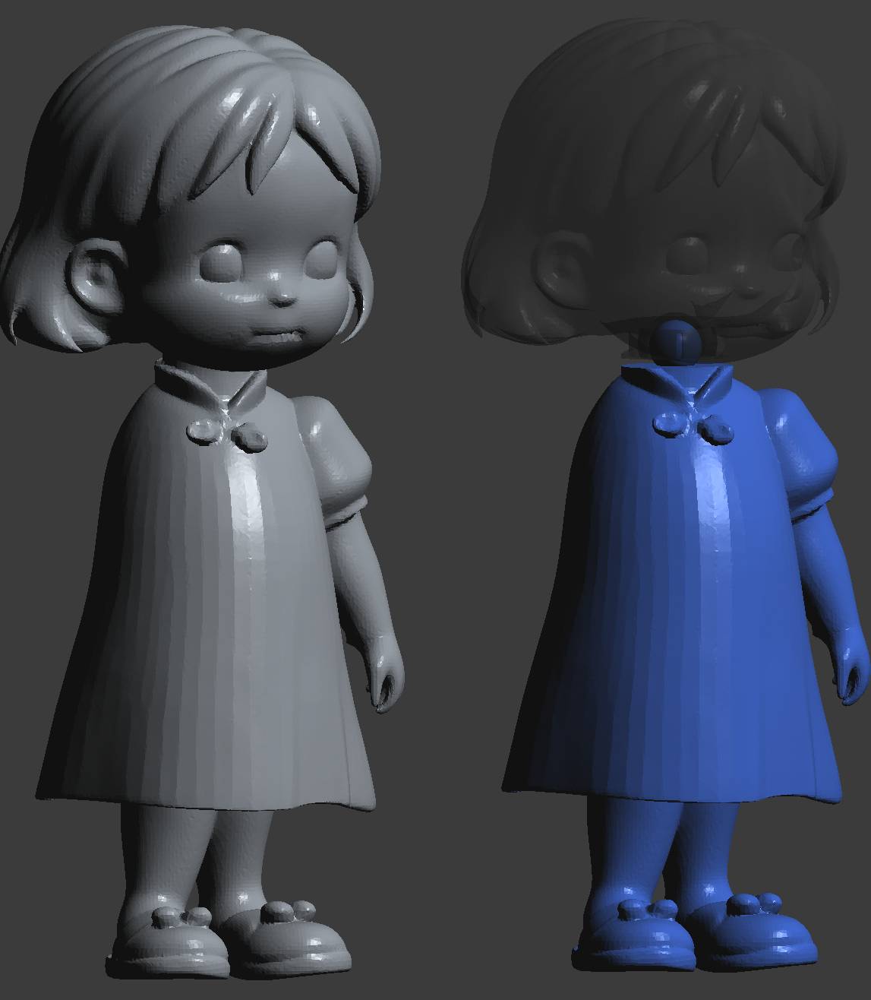